Code for **"Blind restoration of a JPEG-compressed image"** and **"Blind image denoising"** figures. Select `fname` below to switch between the two.

- To see overfitting set `num_iter` to a large value.

# Import libs

In [1]:
from __future__ import print_function
import matplotlib.pyplot as plt
%matplotlib inline

import os
#os.environ['CUDA_VISIBLE_DEVICES'] = '3'

import numpy as np
import seaborn as sns
sns.set()
from models import *

import torch
import torch.optim

from skimage.measure import compare_psnr
from utils.denoising_utils import *

matplotlib.rcParams['text.usetex'] = True
matplotlib.rcParams['text.latex.preamble'] = [r'\usepackage{bm}']

torch.backends.cudnn.enabled = True
torch.backends.cudnn.benchmark =True
dtype = torch.cuda.FloatTensor

imsize =-1
PLOT = True
sigma = 25
sigma_ = sigma/255.

In [2]:
# deJPEG 
# fname = 'data/denoising/snail.jpg'

## denoising
#fname = 'data/denoising/F16_GT.png'
#fname = 'data/bayesian/Covid (450).png'
img_name = 'peppers'
if img_name == 'xray':
    fname = 'data/bayesian/BACTERIA-1351146-0006.jpg'
elif img_name == 'oct':
    fname = 'data/bayesian/CNV-9997680-30.png'
elif img_name == 'us':
    fname = 'data/bayesian/081_HC.jpg'
elif img_name == 'mri':
    fname = 'data/bayesian/gt_mri.png'
elif img_name == 'ct':
    fname = 'data/bayesian/gt_ct.png'
elif img_name == 'peppers':
    fname = 'GP_DIP/data/denoising/Dataset/image_Peppers512rgb.png'

# Load image

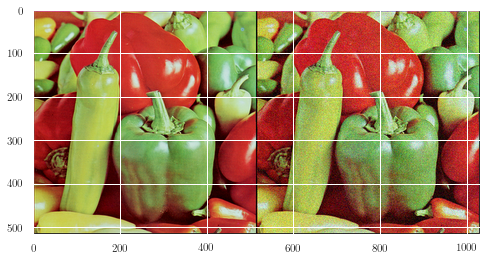

In [3]:
img_pil = crop_image(get_image(fname, imsize)[0], d=32)
#img_pil = img_pil.convert('LA').resize((128,128), resample=Image.ANTIALIAS)#.resize((256,256), resample=Image.ANTIALIAS)
#img_pil.save('resized_%s.png' % img_name)
#img_pil = img_pil.resize((64, 64))
#img_pil.resize((256,256), resample=Image.NEAREST).save('lr_%s.png' % img_name)

img_np = pil_to_np(img_pil)

img_pil = np_to_pil(img_np)
#img_pil = img_pil.convert('LA').resize((128,128), resample=Image.ANTIALIAS)
#img_pil.save('gt_mri.png')
img_np = pil_to_np(img_pil)

img_noisy_pil, img_noisy_np = get_noisy_image(img_np, sigma_)
#img_noisy_pil.resize((256,256), resample=Image.ANTIALIAS).save('noisy_%s.png' % img_name)
if PLOT:
    plot_image_grid([img_np, img_noisy_np], 4, 6);
else:
    assert False

# Setup

In [21]:
INPUT = 'noise' # 'meshgrid'
pad = 'reflection'
OPT_OVER = 'net' # 'net,input'

reg_noise_std = 1./30. # set to 1./20. for sigma=50
LR = 0.01

OPTIMIZER='adam' # 'LBFGS'
show_every = 1000
exp_weight=0.99

num_iter = 20000
input_depth = 32 
figsize = 4 
    
net_input = get_noise(input_depth, INPUT, (img_pil.size[1], img_pil.size[0])).type(dtype).detach()

# Compute number of parameters

#s  = sum([np.prod(list(p.size())) for p in net.parameters()]); 
#print ('Number of params: %d' % s)

# Loss
mse = torch.nn.MSELoss().type(dtype)

#img_noisy_torch = np_to_torch(img_noisy_np).type(dtype)

# Optimize

In [22]:
net_input_saved = net_input.detach().clone()
noise = net_input.detach().clone()
out_avg = None
last_net = None
psrn_noisy_last = 0

#i = 0
def closure():
    
    global i, out_avg, psrn_noisy_last, last_net, net_input, psnrs, losses
    
    if reg_noise_std > 0:
        net_input = net_input_saved + (noise.normal_() * reg_noise_std)
    
    out = net(net_input)
    
    # Smoothing
    if out_avg is None:
        out_avg = out.detach()
    else:
        out_avg = out_avg * exp_weight + out.detach() * (1 - exp_weight)
            
    total_loss = mse(out, img_noisy_torch)
    total_loss.backward()
    
    losses[run].append(total_loss.item())
        
    
    psrn_noisy = compare_psnr(img_noisy_np, out.detach().cpu().numpy()[0]) 
    psrn_gt    = compare_psnr(img_np, out.detach().cpu().numpy()[0]) 
    psrn_gt_sm = compare_psnr(img_np, out_avg.detach().cpu().numpy()[0]) 
    
    psnrs[run].append(psrn_gt)
    
    # Note that we do not have GT for the "snail" example
    # So 'PSRN_gt', 'PSNR_gt_sm' make no sense
    print ('Iteration %05d    Loss %f   PSNR_noisy: %f   PSRN_gt: %f PSNR_gt_sm: %f' % (i, total_loss.item(), psrn_noisy, psrn_gt, psrn_gt_sm), '\r', end='')
    if  PLOT and i % show_every == 0:
        out_np = torch_to_np(out)
        plot_image_grid([np.clip(out_np, 0, 1), 
                         np.clip(torch_to_np(out_avg), 0, 1)], factor=figsize, nrow=1)
    
    # Backtracking
    if i % show_every:
        if psrn_noisy - psrn_noisy_last < -5: 
            print('Falling back to previous checkpoint.')

            for new_param, net_param in zip(last_net, net.parameters()):
                net_param.data.copy_(new_param.cuda())

            return total_loss*0
        else:
            last_net = [x.detach().cpu() for x in net.parameters()]
            psrn_noisy_last = psrn_noisy
            
    #i += 1

    return total_loss

#p = get_params(OPT_OVER, net, net_input)
#optimize(OPTIMIZER, p, closure, LR, num_iter)

In [23]:
targets = {r'Image': img_np, r'Image + noise': img_noisy_np#, 
           #r'Image shuffled': np.random.permutation(img_np.ravel()).reshape(img_np.shape), 
           #r'U(0.1) noise': np.random.uniform(low=0.0, high=1.0, size=img_np.shape)
          }

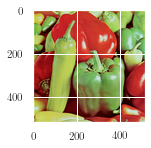

/home/laves/anaconda3/lib/python3.7/site-packages/torch/nn/functional.py:3063: UserWarning: Default upsampling behavior when mode=bilinear is changed to align_corners=False since 0.4.0. Please specify align_corners=True if the old behavior is desired. See the documentation of nn.Upsample for details.
  "See the documentation of nn.Upsample for details.".format(mode))


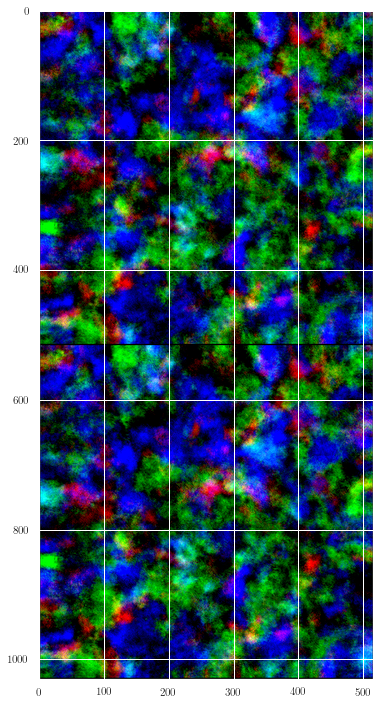

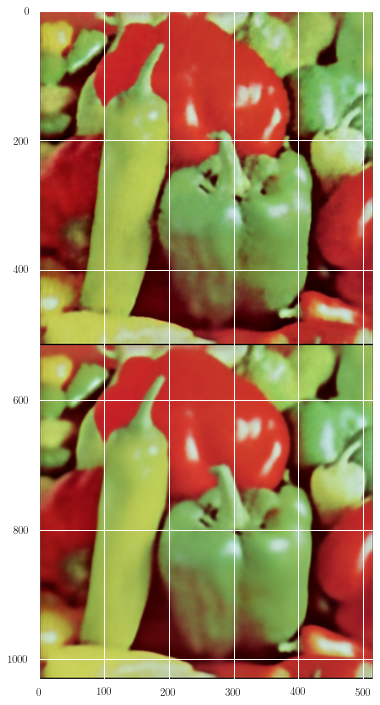

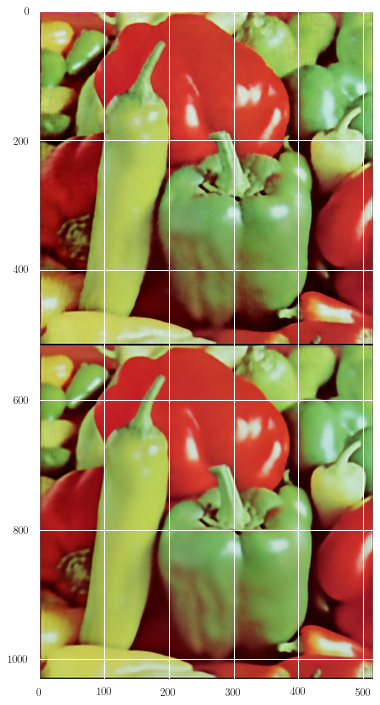

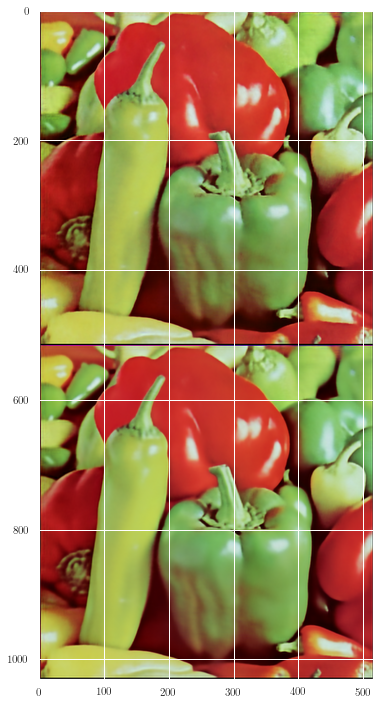

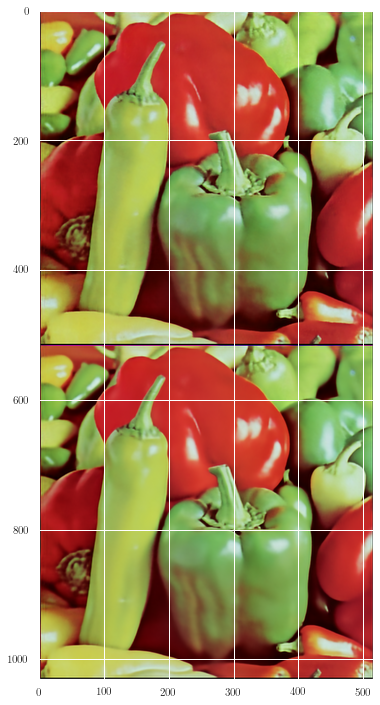

...

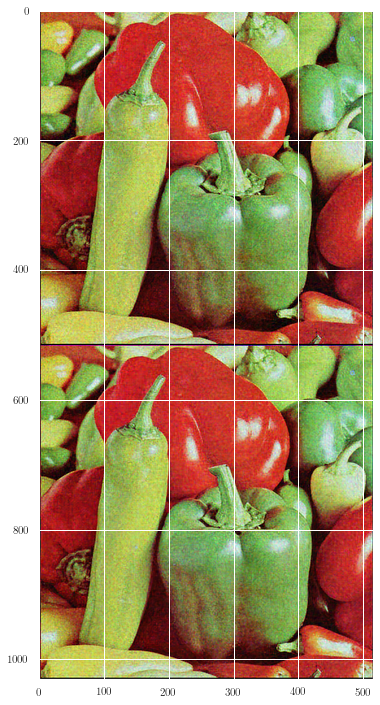

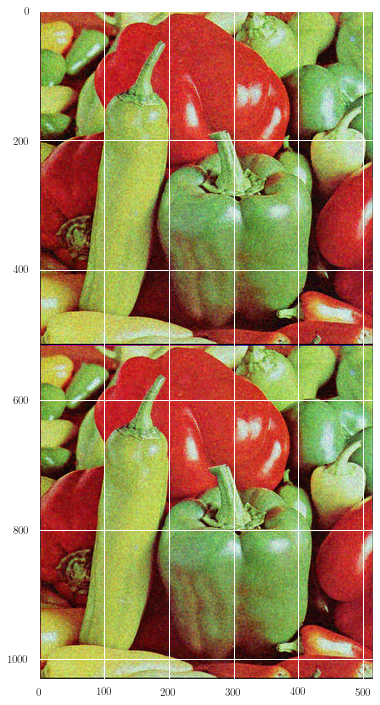

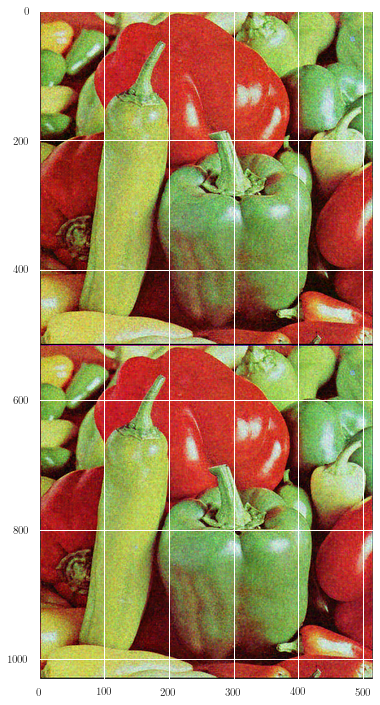

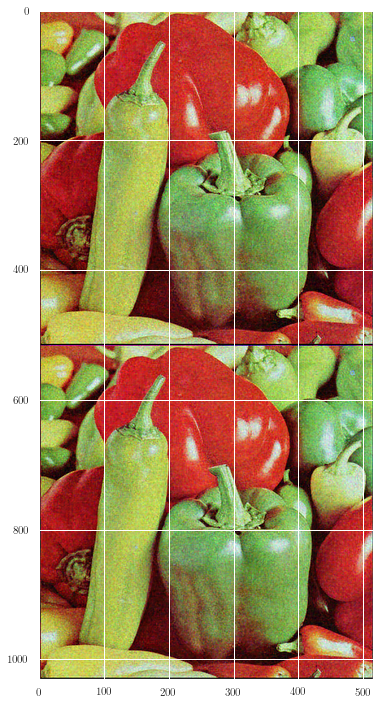

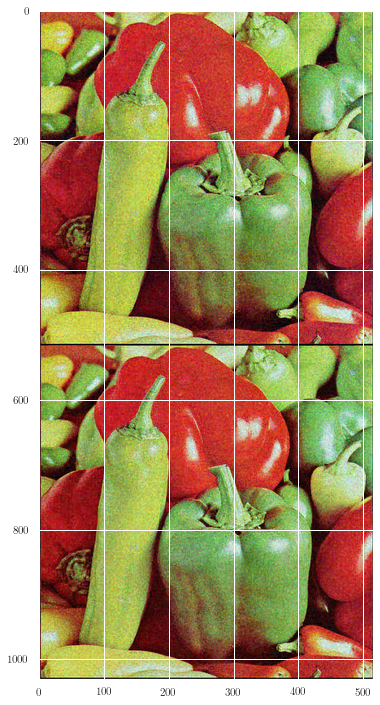

In [24]:
psnrs = {key: [] for key in targets.keys()}
losses = {key: [] for key in targets.keys()}

for run, target in targets.items():
    out_avg = None
    last_net = None
    psrn_noisy_last = 0
    
    plot_image_grid([target])
    
    net = get_net(input_depth, 'skip', pad,
              skip_n33d=128, 
              skip_n33u=128, 
              skip_n11=4, 
              num_scales=5,
              upsample_mode='bilinear').type(dtype)
    
    p = get_params(OPT_OVER, net, net_input)
    
    img_noisy_torch = np_to_torch(target).type(dtype)
    
    optimizer = torch.optim.Adam(p, lr=LR)

    for i in range(num_iter):
        optimizer.zero_grad()
        closure()
        optimizer.step()

In [ ]:
fig, ax = plt.subplots()
for key, values in psnrs.items():
    ax.plot(range(len(values)), values, label=key)
plt.show()

In [26]:
losses2 = torch.load('losses_dip2.pt')
print(list(losses2.keys()))
print(list(losses.keys()))

losses[r'Image shuffled'] = losses2[r'Image shuffled']
losses[r'U(0.1) noise'] = losses2[r'U(0.1) noise']

['Image shuffled', 'U(0.1) noise']
['Image', 'Image + noise']


In [18]:
psnrs1 = torch.load('psnrs_dip.pt')
psnrs2 = torch.load('psnrs_dip2.pt')

psnrs = {}
psnrs[r'Image'] = psnrs1[r'Image']
psnrs[r'Image + noise'] = psnrs1[r'Image + noise']
psnrs[r'Image shuffeld'] = psnrs2[r'Image shuffled']
psnrs[r'U$(0,1)$ noise'] = psnrs2[r'U(0.1) noise']

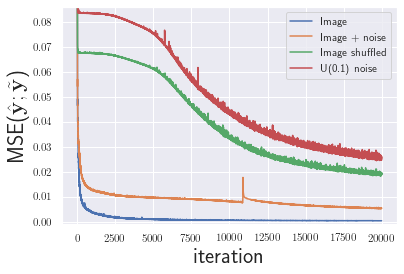

In [27]:
fig, ax = plt.subplots()
for key, values in losses.items():
    ax.plot(range(len(values)), values, label=key)
#ax.set_xscale('log')
ax.set_ylabel(r'MSE($\hat{\mathbf{y}};\tilde{\mathbf{y}}$)', fontsize=22)
ax.set_xlabel(r'iteration', fontsize=22)
ax.set_ylim([-0.001,0.086])
ax.legend()
plt.show()

In [ ]:
out_np = torch_to_np(net(net_input))
q = plot_image_grid([np.clip(out_np, 0, 1), img_np], factor=13);